<a href="https://colab.research.google.com/github/daisysong76/AI--Machine--learning/blob/main/SDOML_dataset_Xiaomei.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# SDO Machine Learning (SDO ML) Dataset

---

## Introduction

### SDO Overview

Since its launch in 2010, NASA’s Solar Dynamics Observatory (SDO; ([Pesnell et al. 2012](https://ui.adsabs.harvard.edu/abs/2012SoPh..275....3P/abstract)) has continuously monitored Sun's activity, delivering a wealth of valuable scientific data for heliophysics researchers with the use of three instruments:

1. The Atmospheric Imaging Assembly (AIA; [Lemen et al. 2012](https://ui.adsabs.harvard.edu/abs/2012SoPh..275...17L/abstract)), which captures 4096 x 4096 resolution images (with 0.6 arcsecond pixel size) of the full Sun in two ultraviolet (centered at 1600, and 1700 Å), seven extreme ultraviolet (EUV; centered at 94, 131, 171, 193, 211, 304, and 335 Å), and one visible (centered at 4500 Å) wavelength band.


2. The Helioseismic and Magnetic Imager (HMI; [Schou et al. 2012](https://ui.adsabs.harvard.edu/abs/2012SoPh..275..229S/abstract)) captures visible wavelength filtergrams of the full Sun at 4096 x 4096 resolution (a pixel size of 0.5 arcsecond), which are then processed into a number of data products, including photospheric Dopplergrams, line-of-sight magnetograms, and vector magnetograms ([Hoeksema et al. 2014](https://ui.adsabs.harvard.edu/abs/2014SoPh..289.3483H/abstract)).


3. The EUV Variability Experiment (EVE; [Woods et al. 2012](https://ui.adsabs.harvard.edu/abs/2012SoPh..275..115W/abstract)) monitors the solar EUV spectral irradiance from 1 to 1050 Å. This is done by utilizing multiple EUV Grating Spectrographs (MEGS) that disperse EUV light from the full disk of the Sun and its corona onto a 1024 x 2048 charge coupled device (CCD).

**Figure 1:** The Solar Dynamics Observatory (SDO) spacecraft, shown with the three main instruments (AIA, EVE, and HMI) highlighted. Image courtesy of NASA (https://sdo.gsfc.nasa.gov).

#Description

The v1 dataset includes AIA/HMI observations 2010-2018 and v2 includes AIA/HMI observations 2010-2020 in all 10 wavebands (94A, 131A, 171A, 193A, 211A, 304A, 335A, 1600A, 1700A, 4500A), with 512x512 resolution and 6 minutes cadence; HMI vector magnetic field observations in Bx, By, and Bz components, with 512x512 resolution and 12 minutes cadence; The EVE observations in 39 wavelengths from 2010-05-01 to 2014-05-26, with 10 seconds cadence.

SDO has 3 instruments:
   AIA 10 channels
   HMI: magnetic field of the solar surface
   EVE: irradiance - but broken after some time

SDO has 20PB data - not manageable, too high resolution, time cadence is high
SDOML:
	data aligned with AIA and HMI
	calibrated
	9Tb for 2010-2023,
	512x512 images every 12min

Irradiance is related to flares
High energy channels are useful for us (X-rays and high UV)
CME, flares (visible in 131 A?), X-rays
SDO is geosynchronous
STEREO has a different orbit (heliocentric at 1AU, precedes earth??)
SDOML v2a version has data until august 2023 - probably what we want to use

There is another version of SDOML with larger cadences in case we need to test different cadences in the pipeline

See all datasets managed by NASA.

Contact
Meng Jin (jinmeng@lmsal.com) and Paul Wright (paul@pauljwright.co.uk)

How to Cite
Solar Dynamics Observatory (SDO) Machine Learning Dataset was accessed on DATE from

 https://registry.opendata.aws/sdoml-fdl.

This gitlab repositery contains python and IDL scripts for getting and processing SDO/AIA and SDO/HMI .fits files to .npz files that are ready for machine learning researches (SDO Machine Learning Dataset). For more details about this dataset, please refer to the following paper:
https://github.com/SDOML/SDOML
https://github.com/SDOML/SDOMLv2

https://ui.adsabs.harvard.edu/abs/2019ApJS..242....7G/abstract

"A Machine-learning Data Set Prepared from the NASA Solar Dynamics Observatory Mission"

https://iopscience.iop.org/article/10.3847/1538-4365/ab1005/pdf

summerize:
https://docs.google.com/document/d/16T-7Cod2cftj0Fm1gZrH7dghHDEgzeA1pkW1q47UYsY/edit

---

## Table of Contents

## 1. Setting up the notebook

In [1]:
!pip install zarr sunpy[all] gcsfs
!pip install s3fs
!pip install numpy matplotlib

In [2]:
import time
import shutil

def backup_notebook(interval=300):
    while True:
        shutil.copy('SDOML_dataset_Xiaomei.ipynb', f'your_notebook_backup_{int(time.time())}.ipynb')
        print("Notebook backed up")
        time.sleep(interval)

# Uncomment the following line to start automatic backups
# backup_notebook()


In [3]:
%matplotlib inline

import gcsfs
import zarr
import sunpy.map
import dask.array as da
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import pandas as pd
import sunpy.visualization.colormaps as cm
from astropy.time import Time
from sunpy.visualization import axis_labels_from_ctype, wcsaxes_compat
from matplotlib import animation
from IPython.display import HTML
import s3fs
import matplotlib.pyplot as plt
import numpy as np
import requests
from PIL import Image
from io import BytesIO
import joblib

# 2. Data Preparation

Download SDO Images: Access and download high-quality images or movies from the SDO website or data archives. The Atmospheric Imaging Assembly (AIA) provides images in multiple wavelengths, which are essential for capturing different features of solar activity.
Preprocess Images: Convert images into a suitable format for model training. This includes resizing, normalization, and augmenting the data to enhance model robustness.

In [4]:

# Initialize s3fs filesystem
s3 = s3fs.S3FileSystem(anon=True)  # Assuming the bucket is publicly accessible

In [5]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [13]:
AWS_ZARR_ROOT = "s3://gov-nasa-hdrl-data1/contrib/fdl-sdoml/"
contents = s3.ls(AWS_ZARR_ROOT)

print("Contents of the S3 path:")
for item in contents:
    print(item)

Contents of the S3 path:
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1


In [14]:

# Define the S3 path
AWS_ZARR_ROOT = "s3://gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/"

# Create an S3 filesystem object
s3 = s3fs.S3FileSystem(anon=True)  # Use anon=False if you need to provide credentials

# List the contents of the S3 path
contents = s3.ls(AWS_ZARR_ROOT)

print("Contents of the S3 path:")
for item in contents:
    print(item)

# Attempt to open the Zarr dataset if it contains the appropriate files
try:
    store = s3fs.S3Map(root=AWS_ZARR_ROOT, s3=s3, check=False)
    zarr_dataset = zarr.open(store, mode='r')

    # Print metadata
    print("\nZarr Dataset Metadata:")
    print(zarr_dataset.info)
    print("\nAttributes:")
    print(zarr_dataset.attrs)
except Exception as e:
    print(f"Error opening Zarr dataset: {e}")


Contents of the S3 path:
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/.sdo_fdmlv1_sync.py.swp
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/12
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2010
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2011
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2012
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2013
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2014
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2015
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2016
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2017
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2018
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/EXPERIMENT_RESULTS
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/Fig4_Active_NR_data.pkl
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/Fig4_Active_ROOT_data.pkl
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/Fig4_Quiet_NR_data.pkl
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdo

In [15]:

# Define the S3 path
AWS_ZARR_ROOT = "s3://gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/"

# Create an S3 filesystem object
s3 = s3fs.S3FileSystem(anon=True)  # Use anon=False if you need to provide credentials

# List the contents of the S3 path
contents = s3.ls(AWS_ZARR_ROOT)

print("Contents of the S3 path:")
for item in contents:
    print(item)

# Inspect a subdirectory, e.g., 2010
subdir_path = f"{AWS_ZARR_ROOT}2010/"
subdir_contents = s3.ls(subdir_path)

print("\nContents of the 2010 subdirectory:")
for item in subdir_contents:
    print(item)

# Check if the subdirectory contains Zarr files
if any('.zarray' in item or '.zgroup' in item for item in subdir_contents):
    try:
        store = s3fs.S3Map(root=subdir_path, s3=s3, check=False)
        zarr_dataset = zarr.open(store, mode='r')

        # Print metadata
        print("\nZarr Dataset Metadata:")
        print(zarr_dataset.info)
        print("\nAttributes:")
        print(zarr_dataset.attrs)
    except Exception as e:
        print(f"Error opening Zarr dataset: {e}")
else:
    print("No Zarr-compatible files found in the subdirectory.")


Contents of the S3 path:
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/.sdo_fdmlv1_sync.py.swp
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/12
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2010
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2011
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2012
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2013
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2014
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2015
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2016
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2017
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2018
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/EXPERIMENT_RESULTS
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/Fig4_Active_NR_data.pkl
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/Fig4_Active_ROOT_data.pkl
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/Fig4_Quiet_NR_data.pkl
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdo

In [7]:
# List the contents of the S3 path
AWS_ZARR_ROOT = "s3://gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2010/01/01"
contents = s3.ls(AWS_ZARR_ROOT)

print("Contents of the S3 path:")
for item in contents:
    print(item)

Contents of the S3 path:
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2010/01/01/AIA20150101_0000_0171.npz
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2010/01/01/AIA20150101_0006_0171.npz
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2010/01/01/AIA20150101_0012_0171.npz
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2010/01/01/AIA20150101_0018_0171.npz
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2010/01/01/AIA20150101_0024_0171.npz
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2010/01/01/AIA20150101_0030_0171.npz
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2010/01/01/AIA20150101_0036_0171.npz
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2010/01/01/AIA20150101_0042_0171.npz
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2010/01/01/AIA20150101_0048_0171.npz
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2010/01/01/AIA20150101_0054_0171.npz
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2010/01/01/AIA20150101_0100_0171.npz
gov-nas

In [6]:
import s3fs

# Set up the S3 file system
s3 = s3fs.S3FileSystem(anon=True)  # Use anon=False if you need to provide credentials

# Define the S3 path and the specific file to download
AWS_ZARR_ROOT = "s3://gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/2010/01/01"
file_to_download = "AIA20150101_0000_0171.npz"
s3_path = f"{AWS_ZARR_ROOT}/{file_to_download}"

# Define the local path to save the file
local_path = f"./{file_to_download}"

# Download the file
s3.get(s3_path, local_path)

print(f"File downloaded to: {local_path}")


File downloaded to: ./AIA20150101_0000_0171.npz


['x']


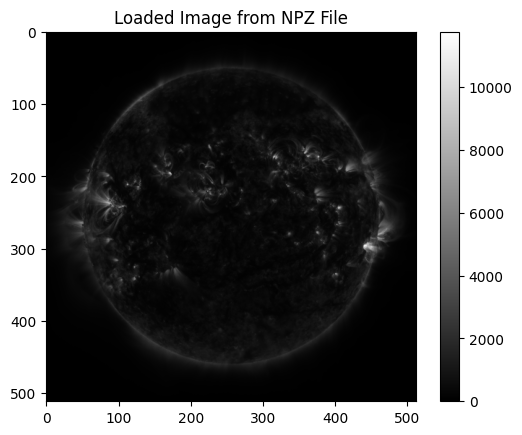

In [7]:

# Load the NPZ file
npz_file = np.load(local_path)

# Assuming the image data is stored under a known key, e.g., 'image'
# List the keys to find out the structure of the NPZ file
print(npz_file.files)

# Replace 'image' with the actual key name if different
image_data = npz_file['x']

# Display the image
plt.imshow(image_data, cmap='gray')  # You can adjust the colormap as needed
plt.colorbar()
plt.title('Loaded Image from NPZ File')
plt.show()


Pixel value range: 0.0 to 11756.4775390625


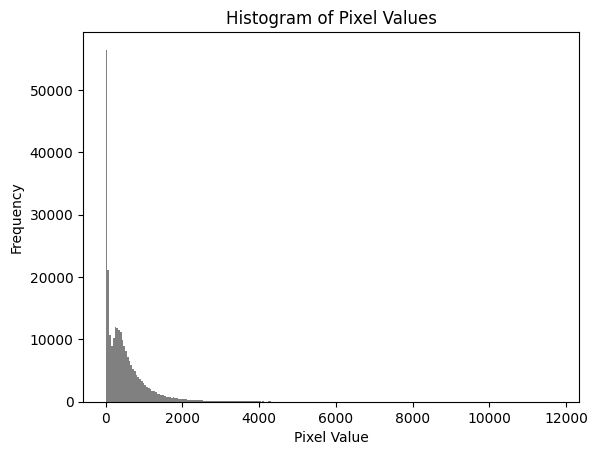

In [8]:
import os
import numpy as np
import matplotlib.pyplot as plt
# Check the range of pixel values
min_value = np.min(image_data)
max_value = np.max(image_data)
print(f"Pixel value range: {min_value} to {max_value}")

# Plot the histogram of pixel values
plt.hist(image_data.flatten(), bins=256, range=(min_value, max_value), color='gray')
plt.title('Histogram of Pixel Values')
plt.xlabel('Pixel Value')
plt.ylabel('Frequency')
plt.show()

In [9]:
# List the contents of the S3 path
AWS_ZARR_ROOT = "s3://gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/"
contents = s3.ls(AWS_ZARR_ROOT)

print("Contents of the S3 path:")
for item in contents:
    print(item)

Contents of the S3 path:
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/.zgroup
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2010
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2011
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2012
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2013
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2014
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2015
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2016
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2017
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2018
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2019
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2020


In [10]:
# Open the Zarr store using the S3 path
store = s3fs.S3Map(root=AWS_ZARR_ROOT, s3=s3, check=False)
zarr_dataset = zarr.open(store, mode='r')  # Use 'open' instead of 'open_consolidated'

# Inspect the dataset structure
print(zarr_dataset.tree())

/
 ├── 2010
 │   ├── 131A (47116, 512, 512) float32
 │   ├── 1600A (47972, 512, 512) float32
 │   ├── 1700A (46858, 512, 512) float32
 │   ├── 171A (47186, 512, 512) float32
 │   ├── 193A (47134, 512, 512) float32
 │   ├── 211A (47186, 512, 512) float32
 │   ├── 304A (47131, 512, 512) float32
 │   ├── 335A (47187, 512, 512) float32
 │   └── 94A (46930, 512, 512) float32
 ├── 2011
 │   ├── 131A (75200, 512, 512) float32
 │   ├── 1600A (75814, 512, 512) float32
 │   ├── 1700A (74839, 512, 512) float32
 │   ├── 171A (75660, 512, 512) float32
 │   ├── 193A (75664, 512, 512) float32
 │   ├── 211A (75678, 512, 512) float32
 │   ├── 304A (74199, 512, 512) float32
 │   ├── 335A (75624, 512, 512) float32
 │   └── 94A (75138, 512, 512) float32
 ├── 2012
 │   ├── 131A (76849, 512, 512) float32
 │   ├── 1600A (76630, 512, 512) float32
 │   ├── 1700A (69091, 512, 512) float32
 │   ├── 171A (76750, 512, 512) float32
 │   ├── 193A (76852, 512, 512) float32
 │   ├── 211A (76870, 512, 512) float32
 │  

In [13]:
data = zarr_dataset["2010"]["131A"]

In [ ]:
# Calculate the percentiles for normalization
vmin, vmax = np.percentile(data, [1, 99.9])

# Normalize the image data
norm_image_data = np.clip(data, vmin, vmax)
norm_image_data = (norm_image_data - vmin) / (vmax - vmin)

colormap = plt.get_cmap('sdoaia131')

# Plot the normalized image data
fig, ax = plt.subplots(1, 1, figsize=(8, 8))
ax.set_axis_off()
cax = ax.imshow(norm_image_data, cmap= colormap, origin='lower')  # Adjust the colormap if needed
fig.colorbar(cax)
ax.set_title('Normalized Image')  # Adjust the title as needed
plt.show()

In [12]:
plt.figure(figsize=(5,5))
colormap = plt.get_cmap('sdoaia171')
plt.imshow(data,origin='lower',vmin=10,vmax=1000,cmap=colormap)

NameError: name 'data' is not defined

<Figure size 500x500 with 0 Axes>

Available keys in the NPZ file: ['x']


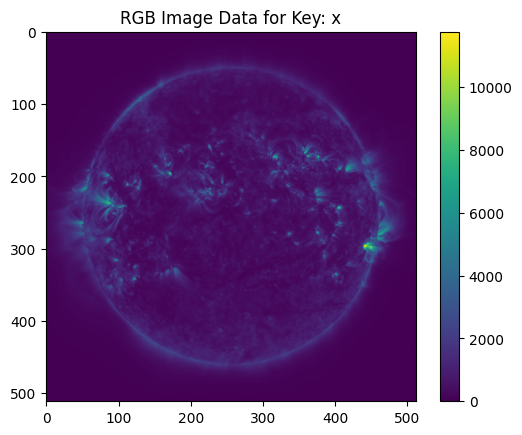

In [ ]:
# Load the NPZ file
npz_file = np.load(local_path)
plt.imshow(data)  # Display RGB image
plt.title(f'RGB Image Data for Key: {key}')
plt.colorbar()
plt.show()

In [ ]:
# # Preprocess image
# img = img.resize((256, 256))  # Resize to 256x256
# img_array = np.array(img) / 255.0  # Normalize pixel values

# 1. SimCLR Pipeline

SimCLR Pipeline

Data Preparation SimCLR requires a large amount of unlabeled data to learn useful representations. The pipeline starts with preparing this data.
Data Collection: Gather a large dataset of unlabeled images.
Data Augmentation: Apply a series of augmentations to each image.

SimCLR uses two random augmentations to create two different views of the same image.
 Random crop and resize
 Random color distortions (brightness, contrast, saturation, hue)
 Random Gaussian blur
 Random horizontal flip

In [ ]:
import tensorflow as tf

def augment(image):
    image = tf.image.random_crop(image, size=[crop_size, crop_size, 3])
    image = tf.image.random_flip_left_right(image)
    image = tf.image.random_brightness(image, max_delta=0.5)
    image = tf.image.random_contrast(image, lower=0.5, upper=1.5)
    image = tf.image.random_saturation(image, lower=0.5, upper=1.5)
    image = tf.image.random_hue(image, max_delta=0.2)
    image = tf.image.resize(image, [target_size, target_size])
    return image

2. Base Encoder Network
SimCLR uses a base encoder network (e.g., ResNet) to extract features from the images.

In [ ]:
base_encoder = tf.keras.applications.ResNet50(include_top=False, weights=None, input_shape=(target_size, target_size, 3), pooling='avg')

3. Projection Head
The output from the base encoder is passed through a small neural network (projection head) to map the representations to a space where contrastive loss is applied.

In [ ]:
projection_head = tf.keras.Sequential([
    tf.keras.layers.Dense(256, activation='relu'),
    tf.keras.layers.Dense(projection_dim)
])

4. Contrastive Loss
SimCLR uses a contrastive loss function, specifically NT-Xent (Normalized Temperature-scaled Cross-Entropy Loss), to maximize the agreement between different views of the same image.

In [ ]:
def contrastive_loss(features, temperature=0.5):
    logits = tf.matmul(features, features, transpose_b=True)
    logits /= temperature
    labels = tf.range(tf.shape(features)[0])
    loss = tf.nn.sparse_softmax_cross_entropy_with_logits(labels, logits)
    return tf.reduce_mean(loss)

5. Training Loop
Train the model using the prepared data, base encoder, and projection head.

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate)

for epoch in range(num_epochs):
    for images in dataset:
        with tf.GradientTape() as tape:
            # Get two different augmentations of the same images
            augmented_images_1 = tf.map_fn(augment, images)
            augmented_images_2 = tf.map_fn(augment, images)

            # Extract features using the base encoder
            features_1 = base_encoder(augmented_images_1, training=True)
            features_2 = base_encoder(augmented_images_2, training=True)

            # Project features to contrastive space
            projections_1 = projection_head(features_1, training=True)
            projections_2 = projection_head(features_2, training=True)

            # Compute contrastive loss
            features = tf.concat([projections_1, projections_2], axis=0)
            loss = contrastive_loss(features)

        gradients = tape.gradient(loss, base_encoder.trainable_variables + projection_head.trainable_variables)
        optimizer.apply_gradients(zip(gradients, base_encoder.trainable_variables + projection_head.trainable_variables))

    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {loss.numpy()}")


6. Fine-Tuning
After training the SimCLR model, fine-tune it on a downstream task with labeled data, such as image classification.

In [ ]:
# Add a classification head
classification_head = tf.keras.Sequential([
    base_encoder,
    tf.keras.layers.Dense(num_classes, activation='softmax')
])

# Compile the model
classification_head.compile(optimizer=tf.keras.optimizers.Adam(learning_rate), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
# Fine-tune on labeled data
classification_head.fit(labeled_dataset, epochs=num_fine_tuning_epochs)


###Summary
Data Preparation: Collect and augment data.
Base Encoder Network: Use a neural network to extract features.
Projection Head: Map features to a space suitable for contrastive loss.
Contrastive Loss: Use NT-Xent loss to train the model.
Training Loop: Train the model using the prepared data and loss function.
Fine-Tuning: Fine-tune the trained model on a downstream task with labeled data.
This pipeline provides a comprehensive approach to training a SimCLR model and fine-tuning it for specific tasks.








# 2. Stable diffusion Model Selection and Setup

Choose a Stable Diffusion Model: Use a pre-trained stable diffusion model. Stable diffusion models are generative models that can generate high-quality images from latent representations.
Modify for Prediction: Adapt the model for predictive tasks. This might involve integrating a neural network that can process input images and predict radiation levels based on learned features.

### Feature Extraction Using Stable Diffusion Model

In [ ]:
import torch
from torchvision import models

# Load pre-trained model
model = models.resnet50(pretrained=True)
model.eval()

# Extract features
img_tensor = torch.tensor(img_array).unsqueeze(0).permute(0, 3, 1, 2).float()
features = model(img_tensor)


#4. Train Predictive Model

Dataset Creation: Create a dataset that includes SDO images paired with corresponding radiation measurements. You can use datasets like GOES Proton Flux data for radiation measurements.
Feature Extraction: Utilize the stable diffusion model to extract features from the SDO images. These features will serve as input for the predictive model.
Model Training: Train the model using supervised learning techniques. The input will be the extracted features, and the output will be the radiation levels.

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

# Create dataset (example with random data)
X = np.random.rand(1000, features.shape[1])  # Feature vectors
y = np.random.rand(1000)  # Radiation levels

# Split dataset
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2)

# Train linear regression model
regressor = LinearRegression()
regressor.fit(X_train, y_train)




4. Evaluation and Optimization
Validation: Split the dataset into training and validation sets to evaluate model performance.
Metrics: Use appropriate metrics like Mean Squared Error (MSE) or R-squared to assess the accuracy of predictions.
Hyperparameter Tuning: Optimize model parameters to improve performance.



In [ ]:

# Evaluate model
y_pred = regressor.predict(X_val)
mse = np.mean((y_val - y_pred) ** 2)
print(f"Mean Squared Error: {mse}")

5. Deployment and Inference
Model Deployment: Deploy the trained model to a production environment where it can process new SDO images.
Real-Time Prediction: Implement a pipeline for real-time prediction, where new SDO images are processed to predict radiation levels.

In [ ]:

def predict_radiation(image_url):
    response = requests.get(image_url)
    img = Image.open(BytesIO(response.content))
    img = img.resize((256, 256))
    img_array = np.array(img) / 255.0
    img_tensor = torch.tensor(img_array).unsqueeze(0).permute(0, 3, 1, 2).float()
    features = model(img_tensor)
    prediction = regressor.predict(features.detach().numpy())
    return prediction


In [ ]:
# Example prediction

image_url = "https://sdo.gsfc.nasa.gov/assets/img/latest/latest_1024_0193.jpg"
predicted_radiation = predict_radiation(image_url)
print(f"Predicted Radiation: {predicted_radiation}")

Additional Resources

SDO Data Access: SDO Data

GOES Proton Flux Data: NOAA NCEI GOES Data

Stable Diffusion Models: You can use diffusion models from libraries like Hugging Face Diffusers.

SDO Data (Resolutions: [ 4096, 2048, 1024, 512 ])
Website: SDO Data
Access: Solar images and magnetic field data.

1. Denoising Diffusion Probabilistic Models (DDPMs)
Overview: DDPMs are generative models that learn to generate data by iteratively denoising a variable from a noisy distribution.
Strengths: Capable of producing high-quality image reconstructions and generating synthetic data. Useful for feature extraction and enhancing image details.
Suitability for Space Weather Prediction: DDPMs can be used to enhance and preprocess SDO images, making it easier to extract meaningful features for radiation prediction.
2. Variational Autoencoders (VAEs)
Overview: VAEs are generative models that learn to encode input data into a latent space and then decode it back to the original data distribution.
Strengths: Effective for learning latent representations of images, which can be used as input features for predictive models.
Suitability for Space Weather Prediction: VAEs can help in learning compact and meaningful representations of SDO images, aiding in the accurate prediction of radiation levels.
3. Generative Adversarial Networks (GANs)
Overview: GANs consist of a generator and a discriminator that are trained together to produce realistic data samples.
Strengths: Excellent at generating high-fidelity images and learning complex data distributions.
Suitability for Space Weather Prediction: GANs can be used to generate synthetic SDO images for data augmentation, improving the robustness of predictive models.
4. Transformers for Vision Tasks (Vision Transformers - ViTs)
Overview: Transformers, originally designed for natural language processing, have been adapted for vision tasks. Vision Transformers (ViTs) apply transformer architectures to image patches.
Strengths: Capable of capturing long-range dependencies and contextual information in images.
Suitability for Space Weather Prediction: ViTs can be used to extract rich features from SDO images, which can then be fed into a regression model to predict radiation levels.

#3.  (Vision Transformers - ViTs)

In [ ]:
import requests
from PIL import Image
import numpy as np
from io import BytesIO
import torch
from transformers import ViTModel, ViTFeatureExtractor
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Function to download and preprocess SDO image
def download_and_preprocess_image(url):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    img = img.resize((256, 256))  # Resize to 256x256
    img_array = np.array(img) / 255.0  # Normalize pixel values
    return img_array

# Function to extract features using Vision Transformer
def extract_features(img_array, model, feature_extractor):
    inputs = feature_extractor(images=img_array, return_tensors="pt")
    outputs = model(**inputs)
    features = outputs.last_hidden_state
    return features

# Function to train predictive model
def train_predictive_model(X, y):
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2)
    regressor = LinearRegression()
    regressor.fit(X_train, y_train)
    y_pred = regressor.predict(X_val)
    mse = mean_squared_error(y_val, y_pred)
    print(f"Mean Squared Error: {mse}")
    return regressor

# Function to predict radiation level from image URL
def predict_radiation(image_url, model, feature_extractor, regressor):
    img_array = download_and_preprocess_image(image_url)
    features = extract_features(img_array, model, feature_extractor)
    features = features.detach().numpy().reshape(1, -1)  # Flatten the feature tensor
    prediction = regressor.predict(features)
    return prediction

# Main script
if __name__ == "__main__":
    # Load pre-trained Vision Transformer
    feature_extractor = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
    vit_model = ViTModel.from_pretrained('google/vit-base-patch16-224')

    # Example dataset (features and corresponding radiation levels)
    # This should be replaced with actual data
    X = np.random.rand(1000, 768)  # Replace 768 with actual feature size from ViT
    y = np.random.rand(1000)  # Replace with actual radiation level data

    # Train the predictive model
    regressor = train_predictive_model(X, y)

    # Example prediction
    image_url = "https://sdo.gsfc.nasa.gov/assets/img/latest/latest_1024_0193.jpg"
    predicted_radiation = predict_radiation(image_url, vit_model, feature_extractor, regressor)
    print(f"Predicted Radiation: {predicted_radiation}")


table diffusion models have seen significant advancements in recent years, particularly in the context of image generation, super-resolution, and denoising. Here are some of the most advanced stable diffusion models:

1. Denoising Diffusion Probabilistic Models (DDPM)
Overview: DDPMs are a type of generative model that iteratively denoise a variable from a Gaussian noise distribution to the desired data distribution.
Strengths: Known for generating high-quality images with diverse details.
Key Papers: "Denoising Diffusion Probabilistic Models" by Jonathan Ho, Ajay Jain, and Pieter Abbeel (2020).
2. Improved Denoising Diffusion Probabilistic Models (IDDPM)
Overview: An extension of DDPMs that improves sampling efficiency and model performance.
Strengths: Reduced the number of sampling steps required, making the model faster and more practical for real-world applications.
Key Papers: "Improved Denoising Diffusion Probabilistic Models" by Alex Nichol and Prafulla Dhariwal (2021).
3. Score-Based Generative Models (SGMs)
Overview: SGMs leverage the idea of score matching, estimating the gradient of the data distribution’s log probability.
Strengths: Provide a unified framework for generative models and achieve state-of-the-art performance in image synthesis tasks.
Key Papers: "Score-Based Generative Modeling through Stochastic Differential Equations" by Yang Song and Stefano Ermon (2021).
4. Latent Diffusion Models (LDMs)
Overview: LDMs are designed to work in a latent space, significantly reducing computational costs while maintaining high quality.
Strengths: Efficient for high-resolution image generation, allowing for practical deployment in applications requiring fast inference.
Key Papers: "High-Resolution Image Synthesis with Latent Diffusion Models" by Robin Rombach et al. (2022).
5. Elucidated Diffusion Models (EDMs)
Overview: EDMs aim to clarify the theoretical underpinnings of diffusion models, improving training stability and performance.
Strengths: Provide insights into the optimal design and training of diffusion models, leading to improved sample quality and diversity.
Key Papers: "Elucidating the Design Space of Diffusion-Based Generative Models" by Tim Salimans and Jonathan Ho (2022).
Example Code Using a Latent Diffusion Model
Below is an example of how you might use a latent diffusion model for image feature extraction and subsequent radiation level prediction:

#4. Latent Diffusion Model

In [ ]:
import requests
from PIL import Image
import numpy as np
from io import BytesIO
import torch
from transformers import ViTModel, ViTFeatureExtractor
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Function to download and preprocess SDO image
def download_and_preprocess_image(url):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    img = img.resize((256, 256))  # Resize to 256x256
    img_array = np.array(img) / 255.0  # Normalize pixel values
    return img_array

# Function to extract features using Vision Transformer
def extract_features(img_array, model, feature_extractor):
    inputs = feature_extractor(images=img_array, return_tensors="pt")
    outputs = model(**inputs)
    features = outputs.last_hidden_state
    return features

# Function to train predictive model
def train_predictive_model(X, y):
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2)
    regressor = LinearRegression()
    regressor.fit(X_train, y_train)
    y_pred = regressor.predict(X_val)
    mse = mean_squared_error(y_val, y_pred)
    print(f"Mean Squared Error: {mse}")
    return regressor

# Function to predict radiation level from image URL
def predict_radiation(image_url, model, feature_extractor, regressor):
    img_array = download_and_preprocess_image(image_url)
    features = extract_features(img_array, model, feature_extractor)
    features = features.detach().numpy().reshape(1, -1)  # Flatten the feature tensor
    prediction = regressor.predict(features)
    return prediction

# Main script
if __name__ == "__main__":
    # Load pre-trained Vision Transformer
    feature_extractor = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
    vit_model = ViTModel.from_pretrained('google/vit-base-patch16-224')

    # Example dataset (features and corresponding radiation levels)
    # This should be replaced with actual data
    X = np.random.rand(1000, 768)  # Replace 768 with actual feature size from ViT
    y = np.random.rand(1000)  # Replace with actual radiation level data

    # Train the predictive model
    regressor = train_predictive_model(X, y)

    # Example prediction
    image_url = "https://sdo.gsfc.nasa.gov/assets/img/latest/latest_1024_0193.jpg"
    predicted_radiation = predict_radiation(image_url, vit_model, feature_extractor, regressor)
    print(f"Predicted Radiation: {predicted_radiation}")




# SDOML v2 dataset

In [ ]:
import s3fs

# Initialize s3fs filesystem
s3 = s3fs.S3FileSystem(anon=True)  # Assuming the bucket is publicly accessible

# Define the path to the .txt file
AWS_ZARR_ROOT = "s3://gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdml-sdomlv1/top-odr-contrib-fdml-sdomlv1.txt"

# Read and print the contents of the .txt file
with s3.open(AWS_ZARR_ROOT, 'r') as file:
    contents = file.read()

print("Contents of the .txt file:")
print(contents)


In [ ]:
# List the contents of the S3 path
AWS_ZARR_ROOT = "s3://gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/"
contents = s3.ls(AWS_ZARR_ROOT)

print("Contents of the S3 path:")
for item in contents:
    print(item)

Contents of the S3 path:
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/.zgroup
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2010
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2011
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2012
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2013
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2014
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2015
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2016
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2017
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2018
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2019
gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/sdomlv2.zarr/2020


In [ ]:
# # this is currently fine for interacting with notebooks from within the project
# gcs = gcsfs.GCSFileSystem(access="read_only")
# loc = "fdl-sdoml-v2/sdomlv2_small.zarr/"
# store = gcsfs.GCSMap(loc, gcs=gcs, check=False)

NameError: name 'gcsfs' is not defined

In [1]:
# List the contents of the S3 path
AWS_ZARR_ROOT = "s3://gov-nasa-hdrl-data1/contrib/fdl-sdoml/fdl-sdoml-v2/"
contents = s3.ls(AWS_ZARR_ROOT)

print("Contents of the S3 path:")
for item in contents:
    print(item)

NameError: name 's3' is not defined

In [ ]:
# Open the Zarr store using the S3 path
store = s3fs.S3Map(root=AWS_ZARR_ROOT, s3=s3, check=False)
zarr_dataset = zarr.open(store, mode='r')  # Use 'open' instead of 'open_consolidated'

# Inspect the dataset structure
print(zarr_dataset.tree())

/
 ├── 2010
 │   ├── 131A (47116, 512, 512) float32
 │   ├── 1600A (47972, 512, 512) float32
 │   ├── 1700A (46858, 512, 512) float32
 │   ├── 171A (47186, 512, 512) float32
 │   ├── 193A (47134, 512, 512) float32
 │   ├── 211A (47186, 512, 512) float32
 │   ├── 304A (47131, 512, 512) float32
 │   ├── 335A (47187, 512, 512) float32
 │   └── 94A (46930, 512, 512) float32
 ├── 2011
 │   ├── 131A (75200, 512, 512) float32
 │   ├── 1600A (75814, 512, 512) float32
 │   ├── 1700A (74839, 512, 512) float32
 │   ├── 171A (75660, 512, 512) float32
 │   ├── 193A (75664, 512, 512) float32
 │   ├── 211A (75678, 512, 512) float32
 │   ├── 304A (74199, 512, 512) float32
 │   ├── 335A (75624, 512, 512) float32
 │   └── 94A (75138, 512, 512) float32
 ├── 2012
 │   ├── 131A (76849, 512, 512) float32
 │   ├── 1600A (76630, 512, 512) float32
 │   ├── 1700A (69091, 512, 512) float32
 │   ├── 171A (76750, 512, 512) float32
 │   ├── 193A (76852, 512, 512) float32
 │   ├── 211A (76870, 512, 512) float32
 │  

In [ ]:
print(zarr_dataset.keys())

KeysView(<zarr.hierarchy.Group '/' read-only>)


## 2. Reading and loading the AIA data


The SDO ML dataset is stored in the Zarr format, a format for the storage of chunked, compressed, N-dimensional arrays with Numpy dtype. For an in-depth overview, see https://zarr.readthedocs.io/en/stable/tutorial.html.

In [ ]:
# first, we create a group with the store data located on GCP.
#root = zarr.group(store)

NameError: name 'store' is not defined

In [ ]:
# Using `root.tree()`, we are able to display the hierarchy (of `loc`).
print(root.tree())

NameError: name 'root' is not defined

As shown in the tree, the heirachy consists of groups, each shown with their respective shape, and data type. In this example, we will primarily look at the 171 Å channel from 2010. This consists of 6135 512x512 images, stored as float32, and can be accessed as follows:

In [ ]:
data = zarr_dataset["2010"]["171A"]

We could have alternatively accessed the 2010 data as:

```
loc = 'fdl-sdoml-v2/sdomlv2_small.zarr/2010'
```

which becomes increasingly useful in the full dataset (where the heirachy contains years 2010 - present).

**Loading with Dask**

We can then load this data into an array using dask.

In [ ]:
all_image = da.from_array(data)
all_image

dask.array<array, shape=(47186, 512, 512), dtype=float32, chunksize=(120, 512, 512), chunktype=numpy.ndarray>

As shown above, the data has the shape (6135, 512, 512), and is split into 52 chunks of (120, 512, 512), each of 125.83 MB; this is further visualised on the right. The data is now in a form to be manipulated like a Numpy array.

We can load and display one image now:

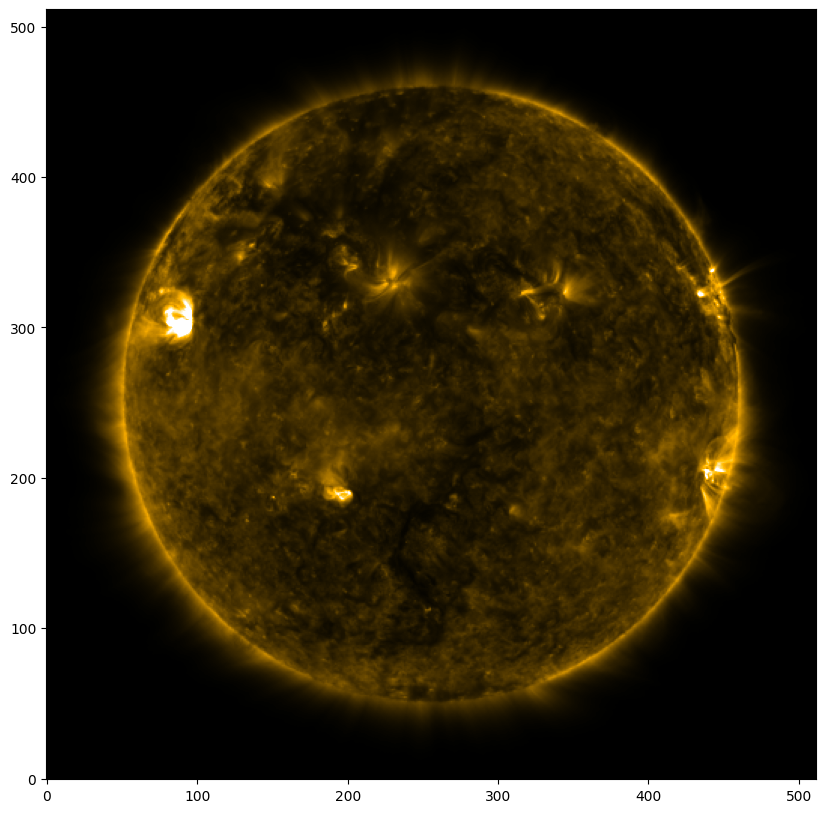

In [ ]:
image=all_image[6000,:,:]
plt.figure(figsize=(10,10))
colormap = plt.get_cmap('sdoaia171')
plt.imshow(image,origin='lower',vmin=10,vmax=1000,cmap=colormap)

Depending on the use-case, we may wish to extract a subset of this data in various ways. In the following sections we step through a number of potential operations that we may wish to make with the data.

### 2a. Selecting images based on header information

The new data includes all fits header information with the same keywords. To find out the AIA keyword definition, one can refer to the following online document:
http://jsoc.stanford.edu/~jsoc/keywords/AIA/AIA02840_K_AIA-SDO_FITS_Keyword_Document.pdf

And one can list all the AIA keywords included:

In [ ]:
sorted(data.attrs)

['ACS_CGT',
 'ACS_ECLP',
 'ACS_MODE',
 'ACS_SAFE',
 'ACS_SUNP',
 'AECDELAY',
 'AECMODE',
 'AECTYPE',
 'AGT1SVY',
 'AGT1SVZ',
 'AGT2SVY',
 'AGT2SVZ',
 'AGT3SVY',
 'AGT3SVZ',
 'AGT4SVY',
 'AGT4SVZ',
 'AIAECENF',
 'AIAECTI',
 'AIAGP1',
 'AIAGP10',
 'AIAGP2',
 'AIAGP3',
 'AIAGP4',
 'AIAGP5',
 'AIAGP6',
 'AIAGP7',
 'AIAGP8',
 'AIAGP9',
 'AIAHFSN',
 'AIASEN',
 'AIAWVLEN',
 'AICFGDL1',
 'AICFGDL2',
 'AICFGDL3',
 'AICFGDL4',
 'AIFCPS',
 'AIFDBID',
 'AIFILTYP',
 'AIFOENFL',
 'AIFRMLID',
 'AIFTSID',
 'AIFTSWTH',
 'AIFWEN',
 'AIHIS192',
 'AIHIS348',
 'AIHIS604',
 'AIHIS860',
 'AIHISMXB',
 'AIMGFSN',
 'AIMGOTS',
 'AIMGOTSS',
 'AIMGSHCE',
 'AIMGSHEN',
 'AIMGTYP',
 'AIMSHCBC',
 'AIMSHCBE',
 'AIMSHCTC',
 'AIMSHCTE',
 'AIMSHOBC',
 'AIMSHOBE',
 'AIMSHOTC',
 'AIMSHOTE',
 'AISTATE',
 'AIVNMST',
 'ASD_REC',
 'ASQFSN',
 'ASQHDR',
 'ASQTNUM',
 'BITPIX',
 'BLANK',
 'BSCALE',
 'BZERO',
 'CAMERA',
 'CAR_ROT',
 'CDELT1',
 'CDELT2',
 'CHECKSUM',
 'COMMENT',
 'CRLN_OBS',
 'CRLT_OBS',
 'CROTA2',
 'CRPIX1',
 'CRPIX

We can extract the exposure (and observation) time from the data attributes (the header information), and downsample our data based upon that information.

In [ ]:
exptime = np.array(data.attrs["EXPTIME"])
t_obs = np.array(data.attrs["T_OBS"])

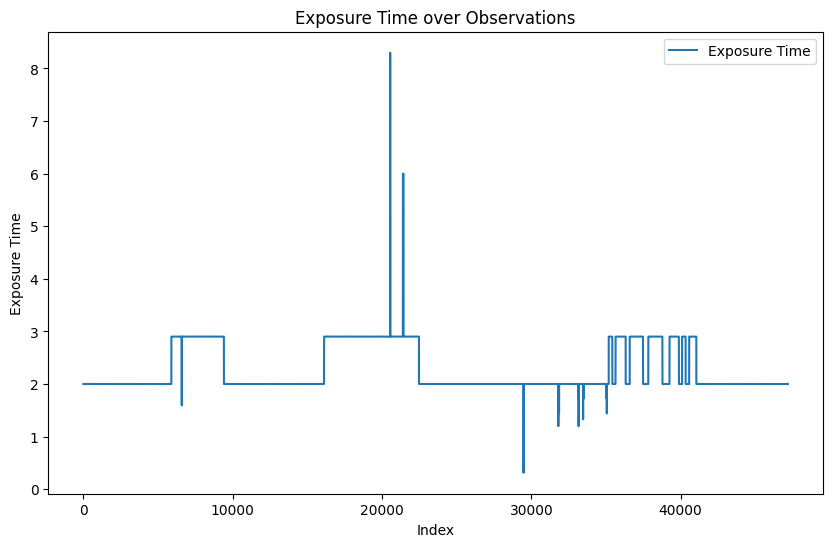

In [ ]:
# Assuming data.attrs is a dictionary containing the attributes
exptime = np.array(data.attrs["EXPTIME"])
t_obs = np.array(data.attrs["T_OBS"])

# Plotting exposure time against index
plt.figure(figsize=(10, 6))
plt.plot(exptime, label='Exposure Time')
plt.xlabel('Index')
plt.ylabel('Exposure Time')
plt.title('Exposure Time over Observations')
plt.legend()
plt.show()

In [ ]:
# select indices where the exposure time is less than 2 seconds
index = np.where(exptime < 2.0)
selected_images = da.from_array(data)[index[0], :, :]

In [ ]:
selected_images

dask.array<getitem, shape=(16984, 512, 512), dtype=float32, chunksize=(120, 512, 512), chunktype=numpy.ndarray>

### 2b. Selecting images based on indices

While the data is not currently ordered by observation time, we can simple index the array to extract a number of observations

In [ ]:
# select a subset of the data based on index
selected_images = da.from_array(data)[100:200, :, :]
selected_header = {keys: values[100:200] for keys, values in data.attrs.items()}

# and even compute the mean of the selected images
print(f"mean of selected images: {da.mean(selected_images).compute():.2f}")

mean of selected images: 109.68


In [ ]:
selected_images

dask.array<getitem, shape=(100, 512, 512), dtype=float32, chunksize=(80, 512, 512), chunktype=numpy.ndarray>

### 2c. Downsampling the data (resolution)

Downsample the 512x512 images to 256x256

In [ ]:
# downsample the data to 256 by sampling every other pixel
sub_index = np.arange(0, 512, 2)

sub_image = da.from_array(data)[0:600, sub_index, :]
sub_image = sub_image[:, :, sub_index]
# is this becuase dask doesn't support nd fancy indexing?

print(f"mean of selected images: {da.mean(sub_image).compute():.2f}")

mean of selected images: 112.15


In [ ]:
sub_image

dask.array<getitem, shape=(600, 256, 256), dtype=float32, chunksize=(120, 256, 256), chunktype=numpy.ndarray>

### 2d. Downsampling the data (temporally)

We can use pandas to downstample the data within a time-range. Here, we choose 1 day of observations at 12 minute frequency

In [ ]:
df_time = pd.DataFrame(t_obs, index=np.arange(np.shape(t_obs)[0]), columns=["Time"])
df_time["Time"] = pd.to_datetime(df_time["Time"])

# select times at a frequency of 12 minutes
selected_times = pd.date_range(
    start="2010-08-28 00:00:00", end="2010-08-28 23:59:59", freq="12T", tz="UTC"
)

In [ ]:
selected_index = []
for i in selected_times:
    selected_index.append(np.argmin(abs(df_time["Time"] - i)))
# may be a more efficient way of doing this
time_index = list(filter(lambda x: x > 0, selected_index))
da.from_array(data)[time_index, :, :]

dask.array<getitem, shape=(120, 512, 512), dtype=float32, chunksize=(61, 512, 512), chunktype=numpy.ndarray>

## 3. Generating a SunPy Map

SunPy is an open-source Python library for Solar Physics data analysis and visualization.

In this section we will demonstrate how SunPy’s [Map](https://docs.sunpy.org/en/stable/api/sunpy.map.Map.html#sunpy.map.Map) with the Zarr-formatted data. We demonstrate this for a single index.

In [ ]:
# specify an image index
img_index = time_index[-1]

In [ ]:
# select the respective image, and header required for sunpy.map.Map()
selected_image = da.from_array(data)[img_index, :, :]
selected_headr = {keys: values[img_index] for keys, values in data.attrs.items()}

In [ ]:
my_map = sunpy.map.Map((np.array(selected_image), selected_headr))

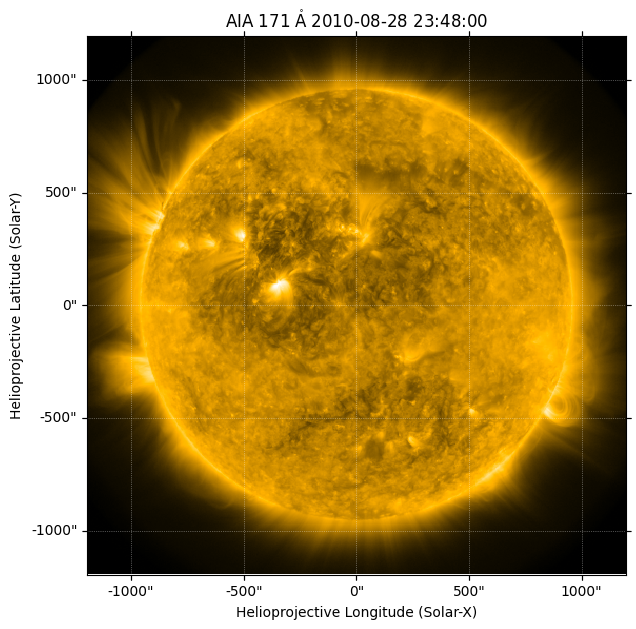

In [ ]:
plt.figure(figsize=(7, 7))
ax = plt.subplot(projection=my_map)
my_map.plot()

As this is then a SunPy Map object, we can manipulate it as such.

Observatory,SDO
Instrument,AIA 3
Detector,AIA
Measurement,171.0 Angstrom
Wavelength,171.0 Angstrom
Observation Date,2010-08-28 23:48:00
Exposure Time,2.000212 s
Dimension,[512. 512.] pix
Coordinate System,helioprojective
Scale,[4.67339278 4.67339278] arcsec / pix
Reference Pixel,[255.25 255.25] pix

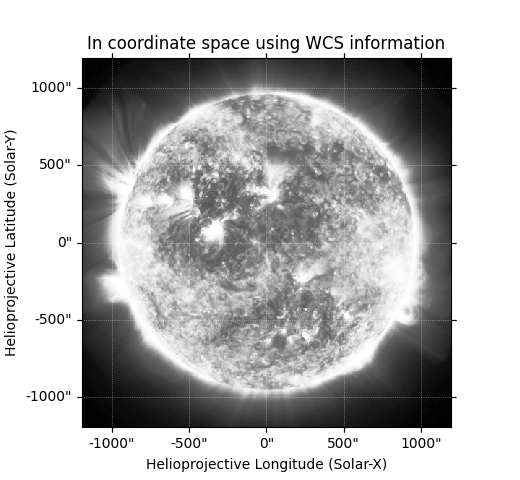
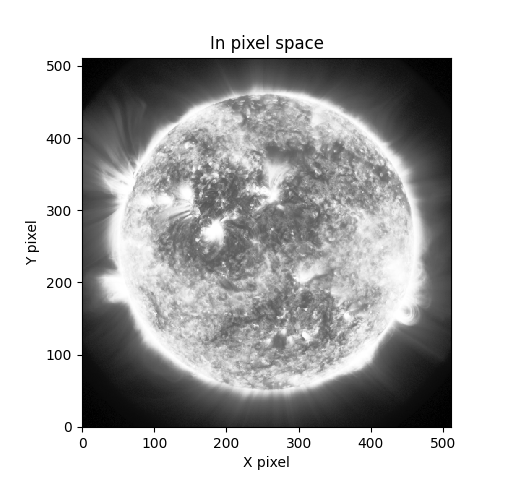
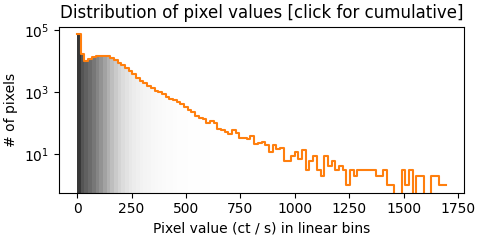
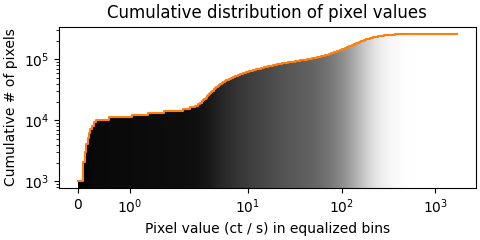

In [ ]:
my_map

For more information about SunPy, and Map, see the SunPy project: https://readthedocs.org/projects/sunpy/

## 4. Generating an AIA animation

In [ ]:
maps = []

for i in time_index:
    selected_image = da.from_array(data)[i, :, :]
    selected_headr = {keys: values[i] for keys, values in data.attrs.items()}
    maps.append(sunpy.map.Map((np.array(selected_image), selected_headr)))

sq = sunpy.map.Map(maps, sequence=True, sortby="date")

In [ ]:
def animate_sequence(sequence, vmin = None, vmax = None):
    """
    An animation plotting routine to animate each element in MapSequence

    Parameters
    ----------
    sequence : `sunpy.map.mapsequence.MapSequence`
        a set of sunpy maps to animate

    Returns
    -------
    `matplotlib.animation.FuncAnimation`
        A FuncAnimation instance.
    """

    # fig, ax = plt.subplots(figsize=(7,7),
    #                       subplot_kw=dict(projection=sequence[0].wcs)
    #                      )

    ax = wcsaxes_compat.gca_wcs(sequence[0].wcs)
    fig = ax.get_figure()
    fig.figsize = (7, 7)

    plot_obj = sequence[0].plot(vmin = vmin, vmax = vmax)
    ax.set_title(sequence[0].latex_name)

    cbar = plt.colorbar()

    def update_fig(i):
        ax.set_title(sequence[i].latex_name)

        # set the data to that of the image being plot
        # Each image should be scaled as the first.
        plot_obj.set_data(sequence[i].data)

        # reset the WCS to that of the image being plot
        plot_obj.axes.reset_wcs(sequence[i].wcs)

        wcsaxes_compat.default_wcs_grid(ax)
        ax.set_xlabel(
            axis_labels_from_ctype(
                sequence[i].coordinate_system[0], sequence[i].spatial_units[0]
            )
        )
        ax.set_ylabel(
            axis_labels_from_ctype(
                sequence[i].coordinate_system[1], sequence[i].spatial_units[1]
            )
        )

        # basic test:
        # expect the wcs of the plot_obj to follow the sequence
        # print(sequence[i].wcs == plot_obj.axes.wcs, sequence[0].wcs == sequence[i].wcs)
        return (plot_obj,)

    anim = animation.FuncAnimation(
        fig, update_fig, init_func=None, frames=len(sequence), interval=60, repeat=True
    )
    plt.close(fig)

    return anim

In [ ]:
anim = animate_sequence(sq)
HTML(anim.to_jshtml())

## 5. Reading and loading HMI data

Now, we demonstrste how to read the HMI data within the SDOML dataset. In general, the HMI data structure is very similar to the AIA data. Instead of 9 AIA channels, for each time step, HMI has 3 channels that represent the 3 component of the vector magnetic field (i.e., Bx, By, and Bz). Using the same method described in section 2, we can load the HMI data in 2010:

In [ ]:
loc_hmi = "fdl-sdoml-v2/sdomlv2_hmi.zarr/2010"
store = gcsfs.GCSMap(loc_hmi, gcs=gcs, check=False)
root = zarr.group(store)
print(root.tree())

Same as AIA data, the new HMI data also includes all fits header information with the same keywords. To find out the HMI keyword definition, one can refer to the following online document:
http://jsoc.stanford.edu/doc/keywords/JSOC_Keywords_for_metadata.pdf

And one can list all the HMI keywords included:

In [ ]:
data = root["Bz"]
sorted(data.attrs)

Note that the HMI keywords are slightly different comparing with AIA keywords. For example, there is no exposure time ('EXPTIME') in the HMI metadata. Also, the 'T_OBS' format is a bit different:

In [ ]:
t_obs = np.array(data.attrs["T_OBS"])
t_obs

To keep it consistent with the AIA metadata, one can simply convert the time format:

In [ ]:
t_obs_new = []
for string in t_obs:
    new_string = string.replace('_TAI', 'Z')
    new_string = new_string.replace('_','T')
    new_string = new_string.replace('.','-')
    new_string = new_string.replace('Z', '.00')
    t_obs_new.append(new_string)
t = Time(t_obs_new, format='isot', scale='tai')
t_obs_new=t.value

Now we can load a magnetic map using Sunpy Map:

In [ ]:
da.from_array(data)[0, :, :]

In [ ]:
selected_headr

In [ ]:
selected_image = da.from_array(data)[0, :, :]
selected_headr = {keys: values[0] for keys, values in data.attrs.items()}
selected_headr['WAVEUNIT'] = 'angstrom'
my_map = sunpy.map.Map((np.array(selected_image), selected_headr))
my_map

We can load a movie of HMI Bz component in the same time range as shown for AIA in the previous section:

In [ ]:
df_time = pd.DataFrame(t_obs_new, index=np.arange(np.shape(t_obs_new)[0]), columns=["Time"])
df_time["Time"] = pd.to_datetime(df_time["Time"])

# select times at a frequency of 12 minutes
selected_times = pd.date_range(
    start="2010-08-28 00:00:00", end="2010-08-28 23:59:59", freq="12T")

selected_index = []
for i in selected_times:
    selected_index.append(np.argmin(abs(df_time["Time"] - i)))

#mark the missing timestamps in the data
missing_index=np.where(abs(df_time['Time'][selected_index]-selected_times)>pd.Timedelta('3m'))[0].tolist()
for i in missing_index:
    selected_index[i]=-1

# may be a more efficient way of doing this
time_index = list(filter(lambda x: x > 0, selected_index))
da.from_array(data)[time_index, :, :]

In [ ]:
maps = []

for i in time_index:
    selected_image = da.from_array(data)[i, :, :]
    selected_headr = {keys: values[i] for keys, values in data.attrs.items()}
    selected_headr['WAVEUNIT'] = 'angstrom'
    maps.append(sunpy.map.Map((np.array(selected_image), selected_headr)))

sq = sunpy.map.Map(maps, sequence=True, sortby="date")

In [ ]:
# The plot range can be specified by vmin and vmax
anim = animate_sequence(sq, vmin=-20, vmax=20)
HTML(anim.to_jshtml())

## 6. Reading and loading EVE data

The EVE data is timeseries data in 39 wavelengths from 2010 May 1 to 2014 May 26. The temporal resolution is 1 minute. In this section, we demonstrate how to read and load EVE data.

In [ ]:
loc_eve = "fdl-sdoml-v2/sdomlv2_eve.zarr"
store = gcsfs.GCSMap(loc_eve, gcs=gcs, check=False)
root = zarr.group(store)
print(root.tree())

As shown in the data structure tree, the ion line names can be identified. For some ions, there are multiple emission lines and the spectral line names end with '_1', '_2' to distinguish them. The details (e.g., ion, wavelength, emission temperature) are included in the metadata, which can be checked similar as AIA and HMI data:

In [ ]:
data = root["MEGS-A"]["Fe XX"]
sorted(data.attrs)

In [ ]:
data.attrs['ion'],data.attrs['wavelength'], data.attrs['logT']

In addition, the 'Time' variable contains all timestamps of the data:

In [ ]:
time = root['MEGS-A']['Time']
time[0:10]

We can plot the spectral line timeseries data:

In [ ]:
df = pd.Series(data,index=pd.to_datetime(time))
ax = df.plot(ylim=(0,2.e-4),figsize=(20,10),fontsize=20)
ax.set_title(str(data.attrs['ion'])+' '+str(data.attrs['wavelength'])+' LogT = '+str(data.attrs['logT']),fontsize=20)
ax.set_xlabel("Time",fontsize=20)
ax.set_ylabel("Intensity [W/m^2]",fontsize=20)

----

This project was conducted during the 2018 NASA Frontier Development Lab (FDL) program, a public/private partnership between NASA and SETI and industry partners including NVIDIA Corporation, Lockheed Martin, and IBM. The authors thank IBM (especially Naeem Altaf) for generously providing computing resources on the IBM Cloud.